# Preparação do ambiente

In [24]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
print("Tamanho do arquivo (bytes):", os.path.getsize('focos_br_todos-sats_2024.csv'))


Tamanho do arquivo (bytes): 904522776


### carregamento do arquivo

In [2]:
try:
    df = pd.read_csv('focos_br_todos-sats_2024.csv')

except FileNotFoundError:
    print("Arquivo 'focos_br_todos-sats_2024.csv' não encontrado. Certifique-se de que ele está no diretório correto.")


# Exploração inicial dos dados

### Informações iniciais do dataframe

In [3]:
df.info()
numeric_cols = df.select_dtypes(include=np.number)
print("Estatísticas descritivas (numéricas):")
display(df.describe())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8144823 entries, 0 to 8144822
Data columns (total 13 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   latitude               float64
 1   longitude              float64
 2   data_pas               object 
 3   satelite               object 
 4   pais                   object 
 5   estado                 object 
 6   municipio              object 
 7   bioma                  object 
 8   numero_dias_sem_chuva  float64
 9   precipitacao           float64
 10  risco_fogo             float64
 11  id_area_industrial     int64  
 12  frp                    float64
dtypes: float64(6), int64(1), object(6)
memory usage: 807.8+ MB
Estatísticas descritivas (numéricas):


,latitude,longitude,numero_dias_sem_chuva,precipitacao,risco_fogo,id_area_industrial,frp
count,8.144823e+06,8.144823e+06,8.133604e+06,8.133604e+06,8.133604e+06,8144823.0,7.808431e+06
mean,-1.005727e+01,-5.340077e+01,2.952733e+01,4.391471e-01,-1.010062e+01,0.0,3.410676e+01
std,5.952386e+00,6.918186e+00,9.935875e+01,2.585437e+00,1.040736e+02,0.0,6.461402e+01
min,-3.371535e+01,-7.372144e+01,-9.990000e+02,0.000000e+00,-9.990000e+02,0.0,-3.800000e+00
25%,-1.384975e+01,-5.777566e+01,6.000000e+00,0.000000e+00,8.200000e-01,0.0,3.400000e+00
50%,-9.166100e+00,-5.358929e+01,2.000000e+01,0.000000e+00,1.000000e+00,0.0,9.100000e+00
75%,-6.498350e+00,-4.820967e+01,6.300000e+01,0.000000e+00,1.000000e+00,0.0,4.440000e+01
max,5.163930e+00,-3.479613e+01,1.200000e+02,2.529800e+02,1.000000e+00,0.0,8.094300e+03


Estatisticas

### Análise de Informações iniciais do dataframe

A exploração de dados apresentou dados suspeitos em 'numero_dias_sem_chuva' por ser um valor que semânticamente não faz sentido ser negativo (não existem dias sem chuva negativos, é 0 ou mais).

Para o caso de 'risco_fogo' e 'frp', embora possuam valores negativos, não sei dizer se isso é correto ou não, a documentação também não diz se é possivel haver valores negativos para essas colunas.

Como eu não estou preparando esse dataframe especificamente para fazer o treinamento de um modelo, acredito que manter outliners o máximo que puder seja a opção mais interessante, já que o objetivo é fazer um dashboard de apresentação dos dados.

## Transformações iniciais do dataframe:

Além disso transformei a coluna 'data_pas' para datetime afim de analisar melhor, e adicionei uma coluna para a divisão e outra para o dia da semana

In [4]:
df['data_pas'] = pd.to_datetime(df['data_pas'], errors='coerce')

if df['data_pas'].isnull().any():
    print("Atenção: Existem valores inválidos na coluna 'data_pas' que foram convertidos para NaT.")
    print("Linhas com NaT:")
    display(df[df['data_pas'].isnull()])

# Criando uma nova coluna 'mes' para armazenar o mês de cada 'data_pas'
df['mes'] = df['data_pas'].dt.month

# Dia da semana como número (0=Segunda, 6=Domingo)
df['dia_semana'] = df['data_pas'].dt.weekday

print("Informações do DataFrame:")
df.info()

Informações do DataFrame:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8144823 entries, 0 to 8144822
Data columns (total 15 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   latitude               float64       
 1   longitude              float64       
 2   data_pas               datetime64[ns]
 3   satelite               object        
 4   pais                   object        
 5   estado                 object        
 6   municipio              object        
 7   bioma                  object        
 8   numero_dias_sem_chuva  float64       
 9   precipitacao           float64       
 10  risco_fogo             float64       
 11  id_area_industrial     int64         
 12  frp                    float64       
 13  mes                    int32         
 14  dia_semana             int32         
dtypes: datetime64[ns](1), float64(6), int32(2), int64(1), object(5)
memory usage: 870.0+ MB


# Valores ausentes

In [5]:
# Contando o número de valores nulos (NaN) em cada coluna
missing_values = df.isnull().sum()
print("Contagem de valores ausentes por coluna:")
print(missing_values[missing_values > 0])

# Calculando a porcentagem de valores ausentes por coluna
missing_percentage = (df.isnull().sum() / len(df)) * 100
print("\nPorcentagem de valores ausentes por coluna:")
print(missing_percentage[missing_percentage > 0].sort_values(ascending=False))

# Identificar as colunas a serem consideradas para remoção de NaNs (todas exceto 'frp')
print(f"DataFrame original antes da remoção de NaNs (exceto 'frp'): {df.shape[0]} linhas")
columns_to_check = df.columns.drop('frp')
df_cleaned = df.dropna(subset=columns_to_check)

print(f"DataFrame após a remoção de NaNs (exceto 'frp'): {df_cleaned.shape[0]} linhas")
df = df_cleaned.copy()

print("\nContagem de valores ausentes por coluna após a remoção:")
print(df.isnull().sum())

Contagem de valores ausentes por coluna:
bioma                         1
numero_dias_sem_chuva     11219
precipitacao              11219
risco_fogo                11219
frp                      336392
dtype: int64

Porcentagem de valores ausentes por coluna:
frp                      4.130133
precipitacao             0.137744
numero_dias_sem_chuva    0.137744
risco_fogo               0.137744
bioma                    0.000012
dtype: float64
DataFrame original antes da remoção de NaNs (exceto 'frp'): 8144823 linhas
DataFrame após a remoção de NaNs (exceto 'frp'): 8133603 linhas

Contagem de valores ausentes por coluna após a remoção:
latitude                      0
longitude                     0
data_pas                      0
satelite                      0
pais                          0
estado                        0
municipio                     0
bioma                         0
numero_dias_sem_chuva         0
precipitacao                  0
risco_fogo                    0
id_area_

### Análise de Valores ausentes
A quantidade de valores ausentes para as colunas 'precipitacao', 'numero_dias_sem_chuva', 'risco_fogo', 'bioma' são ínfimas, podendo excluir as linhas com valores faltantes.<br><br>
Porém a coluna 'frp' possui um número de valores ausentes mais preocupante, devo fazer uma análise mais cuidadosa sobre a distribuição desses dados para escolher a melhor abordagem de inputação, além disso devo verificar primeiros os outliners mais perigosos.

# Dados duplicados

In [6]:
df_duplicated = df.duplicated()
# Contando o número total de linhas duplicadas
num_duplicatas = df_duplicated.sum()
print(f"\nNúmero de linhas duplicadas: {num_duplicatas}")


Número de linhas duplicadas: 0


### Análise
Não há linhas duplicadas.

# Outliners

In [7]:
display(df.describe())

,latitude,longitude,data_pas,numero_dias_sem_chuva,precipitacao,risco_fogo,id_area_industrial,frp,mes,dia_semana
count,8.133603e+06,8.133603e+06,8133603,8.133603e+06,8.133603e+06,8.133603e+06,8133603.0,7.797448e+06,8.133603e+06,8.133603e+06
mean,-1.006430e+01,-5.340961e+01,2024-08-26 13:50:18.465690624,2.952746e+01,4.391472e-01,-1.010050e+01,0.0,3.408784e+01,8.339399e+00,3.029288e+00
min,-3.371535e+01,-7.372144e+01,2024-01-01 00:06:16,-9.990000e+02,0.000000e+00,-9.990000e+02,0.0,-3.800000e+00,1.000000e+00,0.000000e+00
25%,-1.386071e+01,-5.777930e+01,2024-08-10 13:05:53,6.000000e+00,0.000000e+00,8.200000e-01,0.0,3.400000e+00,8.000000e+00,1.000000e+00
50%,-9.169830e+00,-5.359660e+01,2024-09-03 16:26:00,2.000000e+01,0.000000e+00,1.000000e+00,0.0,9.100000e+00,9.000000e+00,3.000000e+00
75%,-6.509400e+00,-4.822158e+01,2024-09-24 11:35:57,6.300000e+01,0.000000e+00,1.000000e+00,0.0,4.430000e+01,9.000000e+00,5.000000e+00
max,5.163930e+00,-3.479613e+01,2024-12-31 23:50:00,1.200000e+02,2.529800e+02,1.000000e+00,0.0,8.094300e+03,1.200000e+01,6.000000e+00
std,5.951345e+00,6.914396e+00,NaN,9.935811e+01,2.585437e+00,1.040730e+02,0.0,6.461029e+01,2.064677e+00,1.961086e+00


## Outliners - dias sem chuva e risco de fogo

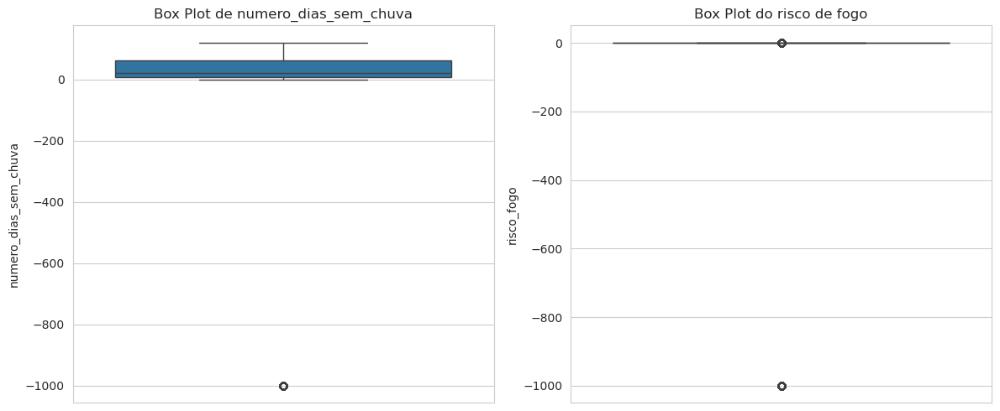

In [8]:
# Configurando o estilo dos gráficos
sns.set_style("whitegrid")

plt.figure(figsize=(12, 5))

# Box plot para 'dias sem chuva'
plt.subplot(1, 2, 1)
sns.boxplot(y=df['numero_dias_sem_chuva'])
plt.title('Box Plot de numero_dias_sem_chuva')
plt.ylabel('numero_dias_sem_chuva')

# Box plot para 'risco_fogo'
plt.subplot(1, 2, 2)
sns.boxplot(y=df['risco_fogo'])
plt.title('Box Plot do risco de fogo')
plt.ylabel('risco_fogo')

plt.tight_layout()
plt.show()

In [9]:
# Calculando Q1, Q3 e IQR para a coluna 'numero_dias_sem_chuva'
Q1 = df['numero_dias_sem_chuva'].quantile(0.25)
Q3 = df['numero_dias_sem_chuva'].quantile(0.75)
IQR = Q3 - Q1

# Definindo os limites para detecção de outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

print(f"Primeiro Quartil (Q1): {Q1:.2f}")
print(f"Terceiro Quartil (Q3): {Q3:.2f}")
print(f"Intervalo Interquartil (IQR): {IQR:.2f}")
print(f"Limite Inferior para Outliers: {lower_bound:.2f}")
print(f"Limite Superior para Outliers: {upper_bound:.2f}")

# Identificando os outliers inferiores
outliers = df[(df['numero_dias_sem_chuva'] < lower_bound)]

print(f"\nNúmero de outliers encontrados em 'numero_dias_sem_chuva': {len(outliers)}")
print("Exemplos de outliers em 'numero_dias_sem_chuva':")
display(outliers.head())

# Contando o número de valores que possuem -999 como numero_dias_sem_chuva
valores_errados = len(df[df['numero_dias_sem_chuva'] == -999])
print("Contagem de valores errados no numero_dias_sem_chuva:")
print(valores_errados)

# Calculando a porcentagem de valores ausentes por coluna
errados_percentage = (valores_errados / len(df)) * 100
print("\nPorcentagem de valores errados em numero_dias_sem_chuva:")
print(errados_percentage)

#######

# Calculando Q1, Q3 e IQR para a coluna 'risco_fogo'
Q1 = df['risco_fogo'].quantile(0.25)
Q3 = df['risco_fogo'].quantile(0.75)
IQR = Q3 - Q1

# Definindo os limites para detecção de outliers
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

print(f"Primeiro Quartil (Q1): {Q1:.2f}")
print(f"Terceiro Quartil (Q3): {Q3:.2f}")
print(f"Intervalo Interquartil (IQR): {IQR:.2f}")
print(f"Limite Inferior para Outliers: {lower_bound:.2f}")
print(f"Limite Superior para Outliers: {upper_bound:.2f}")

# Identificando os outliers
outliers = df[(df['risco_fogo'] < lower_bound)]

print(f"\nNúmero de outliers encontrados em 'numero_dias_sem_chuva': {len(outliers)}")
print("Exemplos de outliers em 'risco_fogo':")
display(outliers.head())

# Contando o número de valores que possuem -999 como risco_fogo
valores_errados = len(df[df['risco_fogo'] == -999])
print("Contagem de valores errados no risco_fogo:")
print(valores_errados)

# Calculando a porcentagem de valores ausentes por coluna
errados_percentage = (valores_errados / len(df)) * 100
print("\nPorcentagem de valores errados em risco_fogo:")
print(errados_percentage)

Primeiro Quartil (Q1): 6.00
Terceiro Quartil (Q3): 63.00
Intervalo Interquartil (IQR): 57.00
Limite Inferior para Outliers: -79.50
Limite Superior para Outliers: 148.50

Número de outliers encontrados em 'numero_dias_sem_chuva': 63631
Exemplos de outliers em 'numero_dias_sem_chuva':


,latitude,longitude,data_pas,satelite,pais,estado,municipio,bioma,numero_dias_sem_chuva,precipitacao,risco_fogo,id_area_industrial,frp,mes,dia_semana
1,-9.55578,-35.70564,2024-01-02 04:08:00,NPP-375D,Brasil,ALAGOAS,MACEIÓ,Mata Atlântica,-999.0,0.0,1.0,0,0.4,1,1
2,-9.55515,-35.71013,2024-01-02 04:08:00,NPP-375D,Brasil,ALAGOAS,MACEIÓ,Mata Atlântica,-999.0,0.0,1.0,0,2.7,1,1
33,-9.91926,-36.00476,2024-01-02 03:19:00,NOAA-20,Brasil,ALAGOAS,JEQUIÁ DA PRAIA,Mata Atlântica,-999.0,0.0,1.0,0,1.9,1,1
34,-9.91489,-36.00393,2024-01-02 03:19:00,NOAA-20,Brasil,ALAGOAS,JEQUIÁ DA PRAIA,Mata Atlântica,-999.0,0.0,1.0,0,1.9,1,1
35,-9.91413,-36.00822,2024-01-02 03:19:00,NOAA-20,Brasil,ALAGOAS,JEQUIÁ DA PRAIA,Mata Atlântica,-999.0,0.0,1.0,0,2.5,1,1


Contagem de valores errados no numero_dias_sem_chuva:
63631

Porcentagem de valores errados em numero_dias_sem_chuva:
0.7823224221787073
Primeiro Quartil (Q1): 0.82
Terceiro Quartil (Q3): 1.00
Intervalo Interquartil (IQR): 0.18
Limite Inferior para Outliers: 0.55
Limite Superior para Outliers: 1.27

Número de outliers encontrados em 'numero_dias_sem_chuva': 1193058
Exemplos de outliers em 'risco_fogo':


,latitude,longitude,data_pas,satelite,pais,estado,municipio,bioma,numero_dias_sem_chuva,precipitacao,risco_fogo,id_area_industrial,frp,mes,dia_semana
3,-7.36323,-39.94515,2024-01-02 04:08:00,NPP-375D,Brasil,PERNAMBUCO,BODOCÓ,Caatinga,7.0,1.32,0.54,0,2.1,1,1
4,-3.51178,-40.13655,2024-01-02 04:06:00,NPP-375D,Brasil,CEARÁ,SANTANA DO ACARAÚ,Caatinga,3.0,3.38,0.00,0,1.0,1,1
5,-21.89247,-46.96316,2024-01-02 04:12:00,NPP-375D,Brasil,SÃO PAULO,VARGEM GRANDE DO SUL,Cerrado,0.0,0.67,0.19,0,0.9,1,1
6,-21.88905,-46.96251,2024-01-02 04:12:00,NPP-375D,Brasil,SÃO PAULO,VARGEM GRANDE DO SUL,Cerrado,0.0,0.64,0.19,0,0.6,1,1
7,-22.05377,-47.90611,2024-01-02 04:12:00,NPP-375D,Brasil,SÃO PAULO,SÃO CARLOS,Cerrado,0.0,0.00,-999.00,0,1.9,1,1


Contagem de valores errados no risco_fogo:
89098

Porcentagem de valores errados em risco_fogo:
1.095430893295382


### Removendo dados errados

In [10]:
# Armazenando o número original de linhas para calcular a porcentagem removida
original_rows = len(df)

# Removendo as linhas onde 'numero_dias_sem_chuva' é -999
df = df[df['numero_dias_sem_chuva'] != -999]

# Removendo as linhas onde 'risco_fogo' é -999
df = df[df['risco_fogo'] != -999]

print(f"DataFrame após a remoção de valores -999: {df.shape[0]} linhas restantes")

# Verificando se os valores foram removidos
valores_errados_dias_chuva_apos_remocao = len(df[df['numero_dias_sem_chuva'] == -999])
valores_errados_risco_fogo_apos_remocao = len(df[df['risco_fogo'] == -999])
print(f"Número de valores -999 em 'numero_dias_sem_chuva' após remoção: {valores_errados_dias_chuva_apos_remocao}")
print(f"Número de valores -999 em 'risco_fogo' após remoção: {valores_errados_risco_fogo_apos_remocao}")

DataFrame após a remoção de valores -999: 7984020 linhas restantes
Número de valores -999 em 'numero_dias_sem_chuva' após remoção: 0
Número de valores -999 em 'risco_fogo' após remoção: 0


### Analise - dias sem chuva e risco de fogo

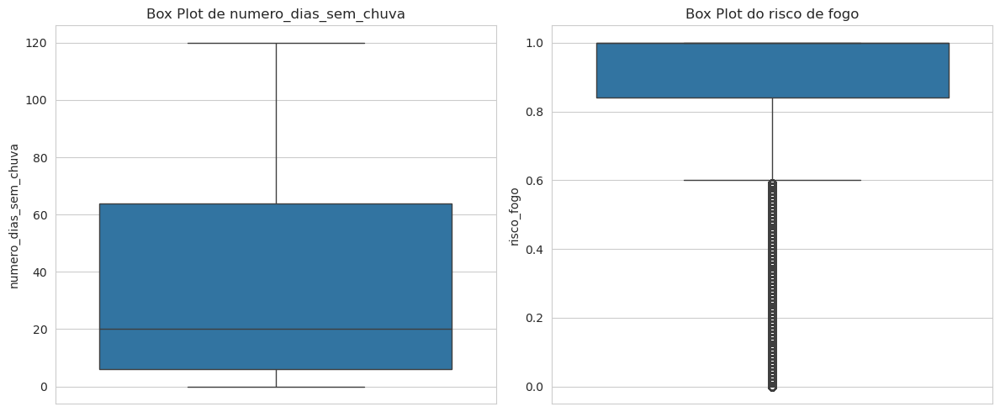

In [11]:
# Configurando o estilo dos gráficos
sns.set_style("whitegrid")

plt.figure(figsize=(12, 5))

# Box plot para 'dias sem chuva'
plt.subplot(1, 2, 1)
sns.boxplot(y=df['numero_dias_sem_chuva'])
plt.title('Box Plot de numero_dias_sem_chuva')
plt.ylabel('numero_dias_sem_chuva')

# Box plot para 'risco_fogo'
plt.subplot(1, 2, 2)
sns.boxplot(y=df['risco_fogo'])
plt.title('Box Plot do risco de fogo')
plt.ylabel('risco_fogo')

plt.tight_layout()
plt.show()

Aparentemente há um número massivo de outliners de grande impacto nas colunas: 'dias_sem_chuva' e 'risco_fogo'. Grande parte desses números parecem possuir o valor -999, o que me leva a crer que é algum erro no dataset, considerando que a porcentagem desses outliners seja tão pequena, resolvi remover as linhas que possuem esse valor.

Para a coluna 'risco_fogo' ainda há um grande número de outliners, mas parece seguir algum tipo de lógica diferente do valor -999. Parecem ser valores reais que indicam lugares com pouquíssimo risco de incêndio, então acredito que o certo seja manter esses dados.

## Valores ausentes de frp

Antes de lidar com os outliners de coluna 'frp' primeiro devemos verificar os valores ausentes dessa coluna, como a porcentagem é um pouco maior do que os outros casos de valores vazios, o ideal é fazer uma inputação, e para decidir se devo fazer por média, ou mediana, devo primeiro analisar sua distribuição. Ironicamente para essa analise os outliners atrapalham a visualização. Então na verdade primeiro devo lidar com os outliners?

### Copiando o dataframe sem dados vazios
Primeiro vou fazer uma copia do dataframe sem os dados vazios, para fazer uma verificação inicial dos dados de 'frp'.

In [12]:
# Calculando a porcentagem de valores ausentes por coluna
missing_percentage_before = (df.isnull().sum() / len(df)) * 100

print("\nPorcentagem de valores ausentes por coluna (antes de remover de 'frp'):")
print(missing_percentage_before[missing_percentage_before > 0].sort_values(ascending=False))

print("\nContagem de valores ausentes por coluna antes da remoção:")
print(df.isnull().sum())

df_cleaned = df.dropna()

# Calculando a porcentagem de valores ausentes por coluna
missing_percentage = (df_cleaned.isnull().sum() / len(df_cleaned)) * 100

print("\nPorcentagem de valores ausentes por coluna (após de remover de 'frp'):")
print(missing_percentage[missing_percentage > 0].sort_values(ascending=False))

print("\nContagem de valores ausentes por coluna após a remoção:")
print(df_cleaned.isnull().sum())


Porcentagem de valores ausentes por coluna (antes de remover de 'frp'):
frp    4.134196
dtype: float64

Contagem de valores ausentes por coluna antes da remoção:
latitude                      0
longitude                     0
data_pas                      0
satelite                      0
pais                          0
estado                        0
municipio                     0
bioma                         0
numero_dias_sem_chuva         0
precipitacao                  0
risco_fogo                    0
id_area_industrial            0
frp                      330075
mes                           0
dia_semana                    0
dtype: int64

Porcentagem de valores ausentes por coluna (após de remover de 'frp'):
Series([], dtype: float64)

Contagem de valores ausentes por coluna após a remoção:
latitude                 0
longitude                0
data_pas                 0
satelite                 0
pais                     0
estado                   0
municipio                0

### Análise de distribuição e inputação

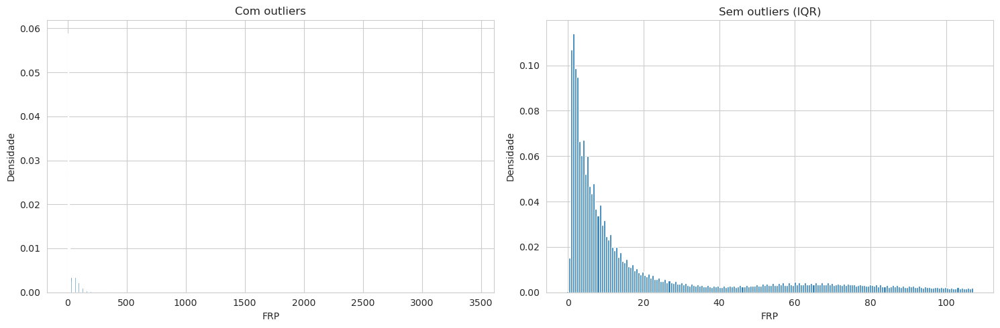

In [13]:
frp = df_cleaned['frp']

# Amostra representativa (ajuste se quiser)
frp_sample = frp.sample(500_000, random_state=42)

Q1 = frp_sample.quantile(0.25)
Q3 = frp_sample.quantile(0.75)
IQR = Q3 - Q1

limite_inferior = Q1 - 1.5 * IQR
limite_superior = Q3 + 1.5 * IQR

frp_sem_outliers = frp_sample[(frp_sample >= limite_inferior) & (frp_sample <= limite_superior)]

fig, axes = plt.subplots(1, 2, figsize=(15, 5))

axes[0].hist(frp_sample, bins=500, density=True)
axes[0].set_title('Com outliers')

axes[1].hist(frp_sem_outliers, bins=200, density=True)
axes[1].set_title('Sem outliers (IQR)')

for ax in axes:
    ax.set_xlabel('FRP')
    ax.set_ylabel('Densidade')

plt.tight_layout()
plt.show()


#### Analise da distribuição de 'frp' 
O gráfico apresenta uma distribuição assimétrica, com a maior parte dos dados à esquerda. A assimetrica me indica a fazer inputação dos dados faltantes com a mediana.

In [14]:
median_frp = df['frp'].median()

df['frp'] = df['frp'].fillna(median_frp)


print("\nContagem de valores ausentes por coluna após a remoção:")
print(df.isnull().sum())


Contagem de valores ausentes por coluna após a remoção:
latitude                 0
longitude                0
data_pas                 0
satelite                 0
pais                     0
estado                   0
municipio                0
bioma                    0
numero_dias_sem_chuva    0
precipitacao             0
risco_fogo               0
id_area_industrial       0
frp                      0
mes                      0
dia_semana               0
dtype: int64


## Outliners - precipitacao e frp

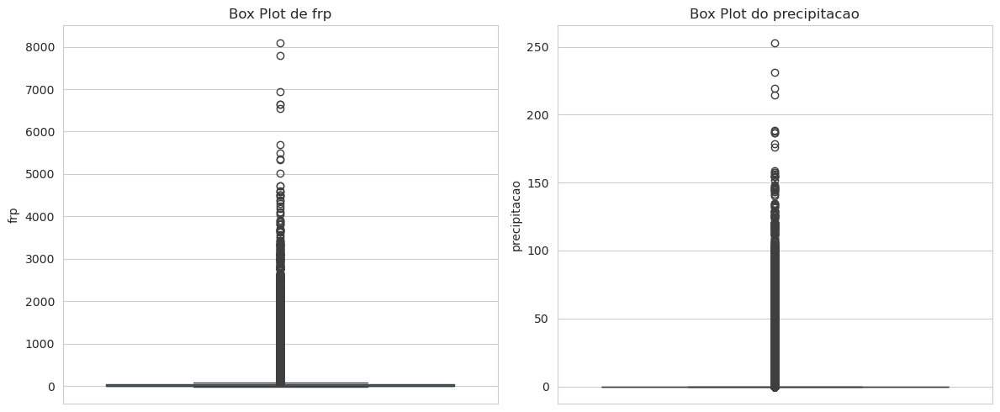

In [15]:
# Configurando o estilo dos gráficos
sns.set_style("whitegrid")

plt.figure(figsize=(12, 5))

# Box plot para 'dias sem chuva'
plt.subplot(1, 2, 1)
sns.boxplot(y=df['frp'])
plt.title('Box Plot de frp')
plt.ylabel('frp')

# Box plot para 'risco_fogo'
plt.subplot(1, 2, 2)
sns.boxplot(y=df['precipitacao'])
plt.title('Box Plot do precipitacao')
plt.ylabel('precipitacao')

plt.tight_layout()
plt.show()

Os valores de precipitação e frp também possuem grande outliners, mas acredito que também seguem uma lógica correta, no caso de precipitação pode ser uma grande chuva captada, e no caso de um alto frp um caso de um grande incêndio, então também decidi manter.

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 7984020 entries, 0 to 8144822
Data columns (total 15 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   latitude               float64       
 1   longitude              float64       
 2   data_pas               datetime64[ns]
 3   satelite               object        
 4   pais                   object        
 5   estado                 object        
 6   municipio              object        
 7   bioma                  object        
 8   numero_dias_sem_chuva  float64       
 9   precipitacao           float64       
 10  risco_fogo             float64       
 11  id_area_industrial     int64         
 12  frp                    float64       
 13  mes                    int32         
 14  dia_semana             int32         
dtypes: datetime64[ns](1), float64(6), int32(2), int64(1), object(5)
memory usage: 913.7+ MB


# Sazonalidade

In [27]:
focos_por_mes = (
    df.groupby('mes')
      .size()
      .reset_index(name='total_focos')
      .sort_values('mes')
)

fig = px.line(
    focos_por_mes,
    x='mes',
    y='total_focos',
    markers=True,
    title='Distribuição mensal dos focos de calor em 2024',
    labels={
        'mes': 'Mês',
        'total_focos': 'Número de focos'
    }
)

fig.show(renderer="notebook")


# Distribuição Regional

In [31]:
focos_por_estado = (
    df.groupby('estado')
      .size()
      .reset_index(name='total_focos')
      .sort_values('total_focos', ascending=False)
)

top_10_estados = focos_por_estado.head(10)

fig = px.bar(
    top_10_estados,
    x='estado',
    y='total_focos',
    title='Top 10 estados com maior número de focos de calor',
    labels={
        'estado': 'Estado',
        'total_focos': 'Número de focos'
    }
)

fig.show('notebook')

display(top_10_estados)

,estado,total_focos
15,PARÁ,1799958
10,MATO GROSSO,1713883
3,AMAZONAS,767876
9,MARANHÃO,567855
26,TOCANTINS,520836
11,MATO GROSSO DO SUL,453209
21,RONDÔNIA,365297
17,PIAUÍ,272101
12,MINAS GERAIS,257274
22,RORAIMA,250366


In [34]:
focos_por_bioma = (
    df.groupby('bioma')
      .size()
      .reset_index(name='total_focos')
      .sort_values('total_focos', ascending=False)
)

fig = px.bar(
    focos_por_bioma,
    x='bioma',
    y='total_focos',
    title='Distribuição dos focos de calor por bioma',
    labels={
        'bioma': 'Bioma',
        'total_focos': 'Número de focos'
    }
)

fig.show('notebook')


In [40]:
df_sample = df.sample(200_000, random_state=42)

fig = px.scatter(
    df_sample,
    x='longitude',
    y='latitude',
    title='Distribuição geográfica dos focos de calor no Brasil (amostra)',
    opacity=0.5,
    labels={
        'longitude': 'Longitude',
        'latitude': 'Latitude'
    }
)

fig.show('notebook')

# Relatório Final

### Exploração Inicial
Durante a exploração incial, a primeira coisa que chamou minha atenção foi o tamanho do dataframe, e principalmente a grande quantidade de outliners e valores suspeitos de estarem errados. De acordo com o objetivo do trabalho, que é fazer um dashboard de apresentação de dados sobre os focos de calor, não vi necessidade de excluir outliners, afinal eles podem indicar acontecimentos que, embora raros, são importantes. Outro ponto importante é a utilização de valores negativos em algumas colunas, na documentaçãos dos dados da INPE nada se fala de quais valores os dados das colunas devem assumir, inclusive, algumas colunas que estão no dataset não são sequer citados na documentação deles o que dificultou a avaliação dessas colunas.

### Valores Ausentes e valores duplicados
Embora não existam valores duplicados, existiam alguns valores ausentes para certas colunas, entre esses o que se destacava era os valores ausentes da coluna 'frp', que ao todo chegavam em torno de 4% dos dados. Graças ao tamanho maior desses dados faltantes comparado aos outros, não é recomendado retirar as linhas desses dados faltantes, então resolvi fazer a inputação desses dados, mas para isso primeiro eu deveria fazr a analise da distribuição desses dados afim de decidir se o dado a ser inputado deve ser a mediana ou a média. Mas antes de fazer essa avaliação, deveria serfeito o tratamento para dados errados.

### Outliners
Sob a perspectiva de que o objetivo final da preparação desses dados seja apresentar a distribuição de focos de calor sob diversas perspectivas, concluí que deveria manter os outliners afim de apresentar, relativamente, os dados de forma mais completa. Apesar dessa abordagem escolhida, alguns dados dentro dos outliners surpreenderam ao apresentar um valor especifico absurdo, esse sendo -999, não apenas em uma coluna, mas em duas. Eu deduzi que a aparição de um número especifico como esse em um número consideravel de linhas deveria indicar uma falha nos dados, e como a porcentagem das linhas com esses erros não eram muito grandes resolvi eliminar as referidas linhas do dataset.

Após lidar com os dados errados, nessa mesma seção, eu analisei os dados faltantes da coluna 'frp', fiz a representação da distribuição dos dados de 'frp' com e sem os outliners, a representação com outliners dificultava muito a visualização, então fiz a avaliação da distribuição sem os outliners, bem como a obtenção do dado a ser inputado. A distribuição em si é assímetrica, por isso o dado escolhido era a mediana.

### Análise dos dados principais
Os gráficos da sazonalidade indicam que a maior parte dos focos de calor aconteceram durante os meses de agosto e setembro, e a região mais afetada foi do bioma da amazônia nos estados do Pará e Mato grosso.

### Conclusão
O analise do dataframe desse notebook tem como objetivo avaliar a melhor forma de apresentar esses dados em um dashboard, mas além desse objetivo esse dataset poderia ser utilizado para outros fins, focado em modelos de aprendizado de máquina, alguns outros objetivos poderiam ser a predição de queimadas, ou identificação delas. Mas acredito que ainda há falta de dados para um aprendizado completo e uma visualização mais clara dos dados, por exemplo nesses dados não há como diferenciar um incêndio de qualquer outro tipo de focod e calor, então alguns focos podem indicar cidades e pontos industriais, então a diferenciação entre ponto de incêndio, e outros pontos de calor deveria ser considerada. Um dado que poderia ajduar a diferencia um ponto de calor de um incendio poderia ser o valor médio de um ponto de calor de incendio e o de uma cidade.
